In [1]:
import sys
import shutil
import os
from pathlib import Path

import torch
from ultralytics import YOLO

import matplotlib.pyplot as plt
import random
import numpy as np
import cv2

/work/home/jae/miniforge3/envs/cvat/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
class Predict:
    def __init__(self, model_path, image_ids, day, night):
        self.model = YOLO(model_path)
        self.image_ids = image_ids
        self.image_paths = []
        self.missing = []
        self.day = day
        self.night = night

    def find_image_paths(self):
        for _id in self.image_ids:    
            image_exists = False
        
            p = Path("/data1/trash_detection_combined")
            
            for images_dir in [str(x) for x in p.iterdir() if x.is_dir()]:
                # print([x for x in p.iterdir() if x.is_dir()])
                if images_dir[len("/data1/trash_detection_combined") + 1] != "0":
                    continue
                if self.day:
                    # print(os.listdir(os.path.join(images_dir, "01_주간")))
                    if "01_주간" in os.listdir(images_dir) and _id in os.listdir(os.path.join(images_dir, "01_주간")):
                        self.image_paths.append(os.path.join(images_dir, "01_주간", _id))
                        image_exists = True
                if self.night:
                    if "02_야간" in os.listdir(images_dir) and _id in os.listdir(os.path.join(images_dir, "02_야간")):
                        self.image_paths.append(os.path.join(images_dir, "02_야간", _id))
                        image_exists = True
        
            if not image_exists:
                self.missing.append(_id)

    def predict(self):
        for image_path in self.image_paths:
            self.model.predict(image_path, save=True, show_labels=False)

    def show(self, results):
        images = []
        
        for image_id in os.listdir(results):
            if image_id in self.image_ids:
                images.append(cv2.cvtColor(cv2.imread(os.path.join(results, image_id)), cv2.COLOR_BGR2RGB))
        
        _, axs = plt.subplots(len(self.image_paths), 1, figsize=(240, 240))
        axs = axs.flatten()
        for image, ax in zip(images, axs):
            ax.imshow(image)
        plt.show()

In [3]:
pile_image_ids = [
    "G0150683.JPG",
    "G0150684.JPG",
    "G0150716.JPG",
    "G0150720.JPG",
    "G0150724.JPG",
    "G0150732.JPG",
    "G0150733.JPG",
    "G0150734.JPG",
    "G0150737.JPG",
    "G0150738.JPG",
    "G0150751.JPG",
    "G0150753.JPG",
    "G0150762.JPG",
    "G0150768.JPG",
    "G0150771.JPG",
    "G0150776.JPG",
    "G0142800.JPG",
    "G0142802.JPG",
    "G0142969.JPG",
    "G0142970.JPG",
    "G0142971.JPG",
    "G0142976.JPG",
    "G0164050.JPG",
    "G0174644.JPG",
    "G0174863.JPG",
    "G0174892.JPG",
    "G0174893.JPG",
    "G-0627_1-00397.JPG",
    "G-0627_1-00400.JPG",
    "G-0627_1-00471.JPG",
    "G0161225.JPG"
]

In [4]:
pile_predict = Predict(
    model_path="/work/home/jae/trash_detection/results/train17/weights/best.pt",
    image_ids=pile_image_ids,
    day=True,
    night=False
)

In [5]:
pile_predict.find_image_paths()

In [6]:
pile_predict.predict()


image 1/1 /data1/trash_detection_combined/0425 제주 2/01_주간/G0150683.JPG: 576x640 7 Pile of somethings, 100.5ms
Speed: 6.1ms preprocess, 100.5ms inference, 2.1ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict15

image 1/1 /data1/trash_detection_combined/0425 제주 2/01_주간/G0150684.JPG: 576x640 5 Pile of somethings, 23.5ms
Speed: 3.6ms preprocess, 23.5ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict15

image 1/1 /data1/trash_detection_combined/0425 제주 2/01_주간/G0150716.JPG: 576x640 9 Pile of somethings, 23.6ms
Speed: 2.7ms preprocess, 23.6ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict15

image 1/1 /data1/trash_detection_combined/0425 제주 2/01_주간/G0150720.JPG: 576x640 8 Pile of somethings, 23.5ms
Speed: 2.7ms preprocess, 23.5ms inference, 1.1ms postproc

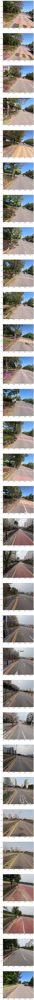

In [7]:
pile_predict.show("/work/home/jae/yolov10/yolov10/runs/detect/predict15")

In [8]:
night_image_ids = [
    "G-0602-00056.JPG",
    "G-0602-00057.JPG",
    "G-0602-00058.JPG",
    "G-0602-00059.JPG",
    "G-0602-00088.JPG",
    "G-0602-00091.JPG",
    "G-0602-00131.JPG",
    "G-0602-00159.JPG",
    "G-0602-00202.JPG",
    "G-0602-00224.JPG",
    "G-0602-00231.JPG",
    "G-0602-00232.JPG",
    "G-0602-00242.JPG",
    "G-N-0627_2-00235.JPG",
    "G-N-0627_2-00239.JPG",
    "G-N-0627_2-00241.JPG",
    "G-N-0627_2-00247.JPG",
    "G-N-0627_2-00257.JPG",
    "G-N-0627_2-00273.JPG",
    "G-N-0627_2-00281.JPG",
    "G-N-0627_2-00301.JPG",
    "G-N-0627_2-00381.JPG",
    "G-N-0627_2-00395.JPG",
    "G-N-0627_2-00672.JPG",
    "G-N-0627_2-00705.JPG",
    "G-N-0628-00071.JPG",
    "G-N-0628-00076.JPG",
    "G-N-0628-00079.JPG",
    "G-N-0628-00125.JPG",
    "G-N-0628-00139.JPG"
]

In [9]:
night_predict = Predict(
    model_path="/work/home/jae/trash_detection/results/train17/weights/best.pt",
    image_ids=night_image_ids,
    day=True,
    night=True
)

In [10]:
night_predict.find_image_paths()

In [11]:
night_predict.predict()


image 1/1 /data1/trash_detection_combined/0602 운정야간/02_야간/G-0602-00056.JPG: 576x640 5 Litters, 24.6ms
Speed: 4.6ms preprocess, 24.6ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict16

image 1/1 /data1/trash_detection_combined/0602 운정야간/02_야간/G-0602-00057.JPG: 576x640 3 Litters, 23.5ms
Speed: 2.7ms preprocess, 23.5ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict16

image 1/1 /data1/trash_detection_combined/0602 운정야간/02_야간/G-0602-00058.JPG: 576x640 3 Litters, 23.6ms
Speed: 2.8ms preprocess, 23.6ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict16

image 1/1 /data1/trash_detection_combined/0602 운정야간/02_야간/G-0602-00059.JPG: 576x640 2 Litters, 23.5ms
Speed: 2.7ms preprocess, 23.5ms inference, 1.2ms postprocess per image at shape (1, 3, 

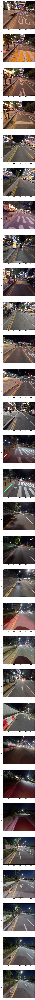

In [12]:
night_predict.show("/work/home/jae/yolov10/yolov10/runs/detect/predict16")

In [3]:
image_ids = [
    "G-0617-03289.JPG",
    "G-0617-03324.JPG",
    "G-0617-03433.JPG"
]

In [5]:
predict = Predict(
    model_path="/work/home/jae/trash_detection/results/train17/weights/best.pt",
    image_ids=image_ids,
    day=True,
    night=False
)

In [6]:
predict.find_image_paths()

In [7]:
predict.predict()


image 1/1 /data1/trash_detection_combined/0616 일산/01_주간/G-0617-03289.JPG: 576x640 3 Litters, 116.5ms
Speed: 7.2ms preprocess, 116.5ms inference, 3.9ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict17

image 1/1 /data1/trash_detection_combined/0616 일산/01_주간/G-0617-03324.JPG: 576x640 1 Litter, 23.7ms
Speed: 4.1ms preprocess, 23.7ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict17

image 1/1 /data1/trash_detection_combined/0616 일산/01_주간/G-0617-03433.JPG: 576x640 5 Litters, 23.7ms
Speed: 4.2ms preprocess, 23.7ms inference, 1.7ms postprocess per image at shape (1, 3, 576, 640)
Results saved to /work/home/jae/yolov10/yolov10/runs/detect/predict17
